<a href="https://colab.research.google.com/github/Kirito-2001/grape-sickness_detection/blob/main/completo_LABIAG.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**SICKNESS OF THE GRAPE RECOGNITION**

The goal of this project is to recognize the sickness of the grape using a yolov5 net, and working on that (training it and making test) using a dataset who is first of all labelled and managed, and then imported here from roboflow.

***in this project we have a complete dataset.***

Flip: Horizontal

Rotation: Between -22° and +22°

Brightness: Between -43% and +43%

Exposure: Between -9% and +9%

# **INSTALL DEPENDENCIES**

 **cloning github yolo and import necessary libraries**

First of all we install the necessary libraries and need to clone the yolov5 repository to use, and later train the yolov5 net.

In [1]:
!git clone https://github.com/ultralytics/yolov5  # clone
%cd yolov5
%pip install -r requirements.txt  # install dependencies

import torch
import os
from IPython.display import Image, clear_output  # to display images
#from utils.downloads import attempt_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Cloning into 'yolov5'...
remote: Enumerating objects: 14391, done.
remote: Counting objects: 100% (12/12), done.
remote: Compressing objects: 100% (9/9), done.
remote: Total 14391 (delta 3), reused 7 (delta 3), pack-reused 14379
Receiving objects: 100% (14391/14391), 13.33 MiB | 1.86 MiB/s, done.
Resolving deltas: 100% (9953/9953), done.
/content/yolov5
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.6 MB 35.3 MB/s 
Setup complete. Using torch 1.12.1+cu113 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


----------------------------------------------------------------------
 **installation of roboflow and dataset download**

Then we have to install roboflow to manage and import our dataset.

In [2]:
%pip install -q roboflow  
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="ultralytics")

     |████████████████████████████████| 145 kB 38.3 MB/s 
     |████████████████████████████████| 178 kB 70.9 MB/s 
     |████████████████████████████████| 67 kB 6.0 MB/s 
     |████████████████████████████████| 54 kB 3.0 MB/s 
     |████████████████████████████████| 138 kB 68.5 MB/s 
     |████████████████████████████████| 62 kB 332 kB/s 
upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


-----------------------------------------------------------------------
**set up of enviroment**

Set up of enviroment to create the directory in which we will store our dataset.


In [3]:
# set up enviroment
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

------------------------------------------------------------------------
**download of dataset**

Let's download the dataset.

In [4]:
rf = Roboflow(api_key="sf9LEmu6xq57r1BlIY3W")
project = rf.workspace("sapienza-af9jq").project("grape-sickness")
dataset = project.version(6).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/datasets/grape-sickness-6 in yolov5pytorch:: 100%|██████████| 1156/1156 [00:00<00:00, 1602.65it/s]


# **DIRECTORIES PATH**

**the structure of our directories should be:**


```
 content/ 
   |-- datasets 
   |      |-- grape-sickness 
   |           | 
   |           |-- test
   |           |    |-- images
   |           |    |-- labels
   |           |
   |           |-- train
   |           |    |-- images
   |           |    |-- labels
   |           |
   |           |-- valid
   |           |    |-- images
   |           |    |-- labels
   |           |    |-- images
   |           |    |-- labels
   |           |
   |           |-- README.dataset.txt
   |           |-- README.roboflow.txt
   |           |-- data.yaml
   |
   |-- sample_data
   |-- yolov5
```




# **TRAIN**

We start the training of the YoloV5.

Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** set the path to our yaml file
- **weights:** specify a custom path to weights. (Note: you can download weights from the Ultralytics Google Drive [folder](https://drive.google.com/open?id=1Drs_Aiu7xx6S-ix95f9kNsA6ueKRpN2J))
- **cache:** cache images for faster training

In [5]:
!python train.py --img 383 --batch 16 --epochs 250 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/datasets/grape-sickness-6/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=250, batch_size=16, imgsz=383, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-205-geef9057 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hs

 **SHOW DETAILS OF TRAINING**

We use tensorboard to show the results of the training.

In [6]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

 **DETECTION**

We make detection on the best result file (best.pt), to see if it really works.

In [7]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 383 --conf 0.4 --source {dataset.location}/valid/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/grape-sickness-6/valid/images, data=data/coco128.yaml, imgsz=[383, 383], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-205-geef9057 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
WARNING ⚠️ --img-size [383, 383] must be multiple of max stride 32, updating to [384, 384]
image 1/26 /content/datasets/grape-sickness-6/valid/images/20220914_104431_00081_15__jpg.rf.641d9aa3af78944c812abec0238021e1.jpg: 384x288 3 the-sickness-of-the-grapes, 10.8ms
image 2/26 /content/datasets/grape-sickness-6/valid/i

---------------------------------------------------------------------
**DISPLAYING** 

Let's display the results of the detection.

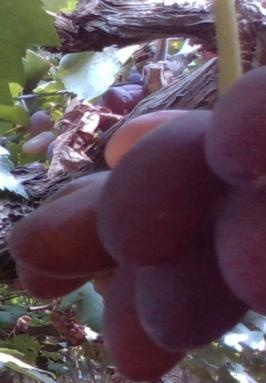

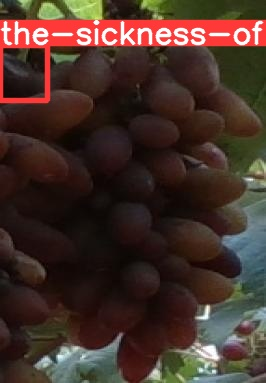

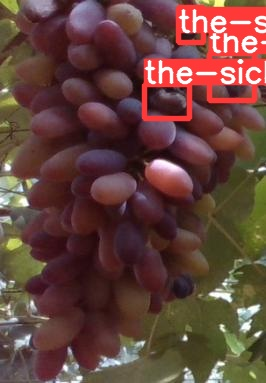

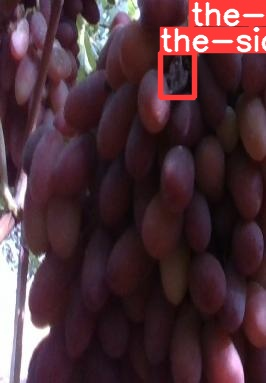

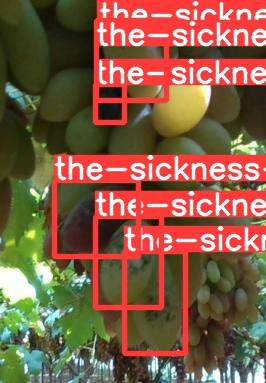

...

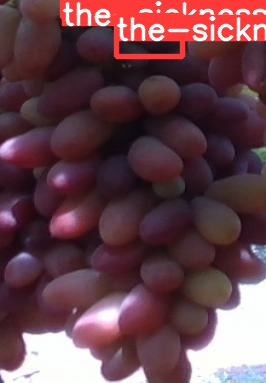

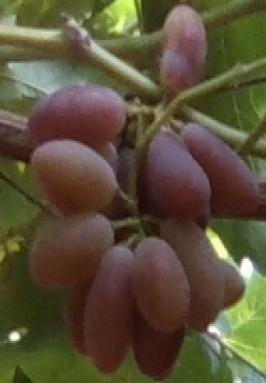

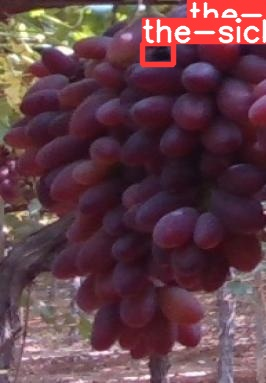

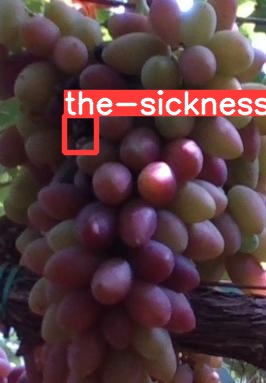

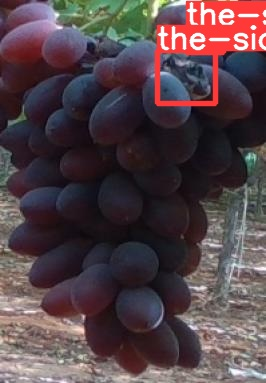

In [8]:
import glob
from IPython.display import Image, display

i = 0 
for imageName in glob.glob("/content/yolov5/runs/detect/exp/*.jpg"):
  i +=1
  if(i<26):
    display(Image(filename=imageName))
    print("\n")

# **TRAIN 2**

We train the same model with less epoch to see differents results.

In [9]:
!python train.py --img 383 --batch 16 --epochs 100 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/datasets/grape-sickness-6/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=383, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
remote: Enumerating objects: 5, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 5 (delta 0), reused 1 (delta 0), pack-reused 0
Unpacking objects: 100% (5/5), done.
From https://github.com/ultralytics/yolov5
   eef9057..fba61e5  master     -> origin/master
github: ⚠️ YOLOv5 is out of date by 1 commit. Use `git pull` 

 **SHOW DETAILS OF TRAINING**

We use tensorboard to show the results of the training.

In [10]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 480), started 0:12:39 ago. (Use '!kill 480' to kill it.)

<IPython.core.display.Javascript object>

**DETECTION on the new model**

In [11]:
!python detect.py --weights runs/train/exp2/weights/best.pt --img 383 --conf 0.4 --source {dataset.location}/valid/images

detect: weights=['runs/train/exp2/weights/best.pt'], source=/content/datasets/grape-sickness-6/valid/images, data=data/coco128.yaml, imgsz=[383, 383], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-205-geef9057 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
WARNING ⚠️ --img-size [383, 383] must be multiple of max stride 32, updating to [384, 384]
image 1/26 /content/datasets/grape-sickness-6/valid/images/20220914_104431_00081_15__jpg.rf.641d9aa3af78944c812abec0238021e1.jpg: 384x288 3 the-sickness-of-the-grapes, 11.3ms
image 2/26 /content/datasets/grape-sickness-6/valid/

**Displaying results of detection**

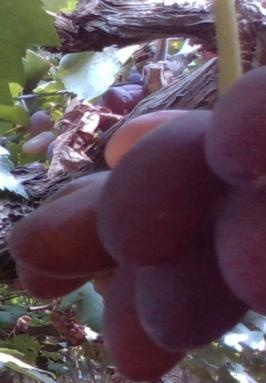

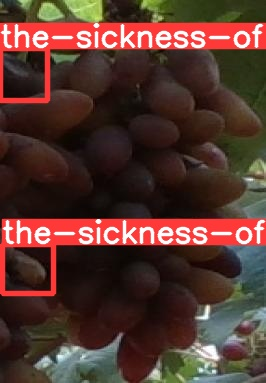

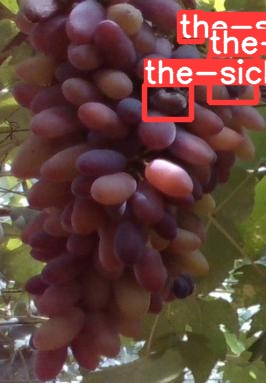

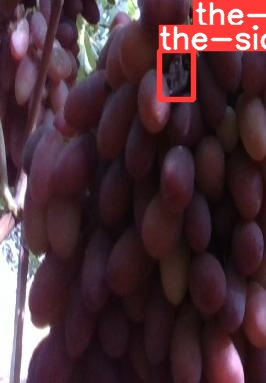

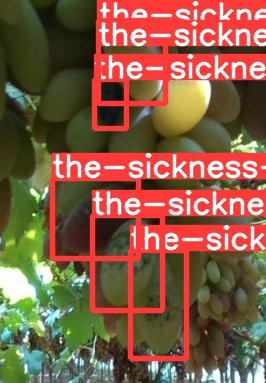

...

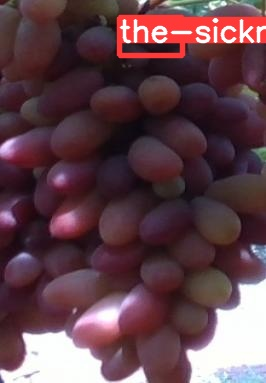

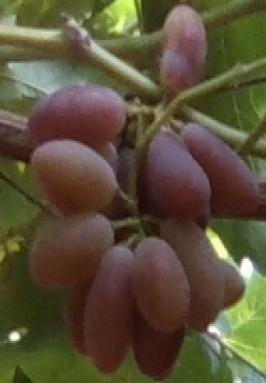

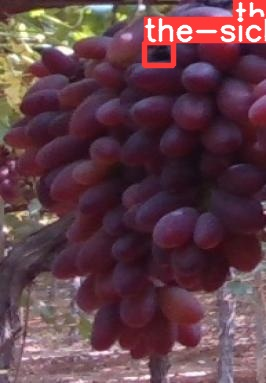

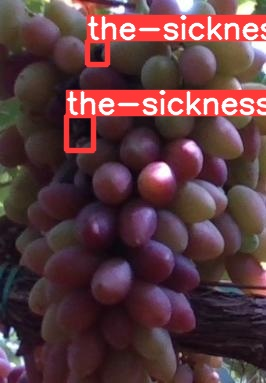

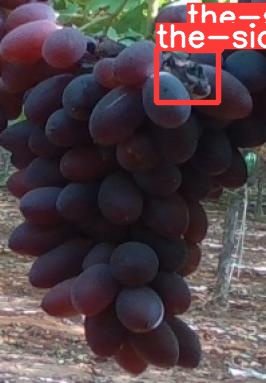

In [12]:
import glob
from IPython.display import Image, display

i = 0 
for imageName in glob.glob("/content/yolov5/runs/detect/exp2/*.jpg"):
  i +=1
  if(i<26):
    display(Image(filename=imageName))
    print("\n")

# **SAVE MODEL**

In [13]:
from google.colab import files
files.download("./runs/train/exp/weights/best.pt")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>